# CN - Ex2 - Real networks
## Author: Aleix Solanes

In [5]:
import igraph,cairo
import community
import louvain
import networkx as nx

# function to export to .clu by a received list of numbers that refer to a cluster
def export_to_clu(list1,file_name):
    out = '*Vertices ' + str(len(list1)) + '\n'
    for a in list1:
        out += str(a+1)+'\n'
    text_file = open(file_name, "w")
    text_file.write(out)
    text_file.close()

## Real networks

In [6]:
# real
net_airports = igraph.read("networks/real/airports_UW.net",format="pajek")
net_cortex = igraph.read("networks/real/cat_cortex_sim.net",format="pajek")
net_dolphins = igraph.read("networks/real/dolphins.net",format="pajek")
net_football = igraph.read("networks/real/football.net",format="pajek")
net_zachary = igraph.read("networks/real/zachary_unwh.net",format="pajek")

clu_cortex = igraph.read("networks/real/cat_cortex_sim.clu",format="pajek")
clu_dolphins = igraph.read("networks/real/dolphins-real.clu",format="pajek")
clu_football = igraph.read("networks/real/football-conferences.clu",format="pajek")
clu_zachary = igraph.read("networks/real/zachary_unwh-real.clu",format="pajek")

### Airports_UW

In [7]:
airports_layout = net_airports.layout("kk")
#labels = [vertex['id'] for vertex in net_airports.vs]
igraph.plot(net_airports, "net_airports.png", vertex_color="cyan", layout = airports_layout)

In [8]:
# Community multilevel
com_airports = net_airports.community_multilevel()
print "Community:"
print com_airports
print "Membership:"
print com_airports.membership
print "Number of communities:", max(com_airports.membership)+1
mem_airports = com_airports.membership
print "Modularity:", com_airports.modularity
export_to_clu(com_airports.membership,"clu_multilevel_airports.clu")
igraph.plot(com_airports,"clu_multilevel_airports.png",layout = airports_layout)

Community:
Clustering with 3618 elements and 35 clusters
[ 0] 329, 452, 568, 662, 770, 853, 928, 1722, 2174, 2244
[ 1] 6, 83, 93, 141, 225, 292, 313, 376, 402, 470, 517, 520, 522, 527, 539,
     540, 558, 627, 636, 681, 714, 732, 739, 746, 782, 842, 917, 919, 941,
     1077, 1087, 1105, 1108, 1114, 1131, 1136, 1138, 1165, 1173, 1178, 1202,
     1204, 1239, 1258, 1318, 1326, 1330, 1338, 1341, 1351, 1357, 1384, 1405,
     1448, 1452, 1496, 1519, 1531, 1538, 1585, 1591, 1673, 1685, 1754, 1769,
     1773, 1775, 1777, 1782, 1783, 1829, 1850, 2034, 2074, 2088, 2101, 2117,
     2122, 2143, 2668, 2672, 2678, 2680, 2685, 2705, 2826, 2842, 2847, 2855,
     2867, 2884, 2912, 2977, 3024, 3059, 3061, 3121, 3146, 3240, 3271, 3290,
     3293, 3302, 3311, 3313, 3314, 3319, 3321, 3330, 3350, 3410, 3412, 3415,
     3444, 3448, 3449, 3576, 3589, 3611
[ 2] 14, 720, 969, 1124, 1336
[ 3] 163, 254, 702, 1012, 1028, 1339, 1993, 2459, 2926, 3037
[ 4] 42, 126, 139, 144, 182, 183, 204, 207, 211, 222, 234, 237, 2

In [9]:
# Community fast-greedy
# simplified to avoid multiple edges in same node pair
com_airports = net_airports.simplify().community_fastgreedy().as_clustering()
print "Optimal number of clusters:",net_airports.community_fastgreedy().optimal_count
print "Community:"
print com_airports
print "Membership:"
print com_airports.membership
print "Number of communities:", max(com_airports.membership)+1
mem_airports = com_airports.membership
print "Modularity:", com_airports.modularity
export_to_clu(com_airports.membership,"clu_fastgreedy_airports.clu")
igraph.plot(com_airports,"clu_fastgreedy_airports.png", layout = airports_layout)

Optimal number of clusters: 42
Community:
Clustering with 3618 elements and 42 clusters
[ 0] 0, 64, 74, 75, 189, 358, 882, 1014, 1152, 1182, 1252, 1479, 1800, 1863,
     1873, 1903, 1947, 1954, 2007, 2016, 2095, 2404, 2465, 2483, 2516, 2518,
     2580, 2928, 2952, 2956, 3033, 3318
[ 1] 1, 2, 3, 4, 5, 8, 9, 10, 19, 20, 24, 27, 28, 29, 33, 35, 36, 37, 41, 43,
     51, 53, 54, 58, 59, 63, 66, 68, 77, 78, 79, 80, 81, 85, 95, 97, 99, 101,
     106, 110, 113, 115, 116, 119, 121, 123, 125, 129, 131, 134, 135, 142,
     143, 146, 154, 155, 156, 159, 162, 165, 168, 171, 177, 181, 185, 190,
     197, 200, 203, 205, 206, 213, 215, 216, 219, 220, 221, 226, 227, 229,
     233, 238, 239, 245, 248, 249, 251, 253, 257, 258, 259, 263, 269, 270,
     275, 280, 282, 283, 285, 287, 289, 291, 294, 299, 300, 301, 302, 306,
     307, 315, 318, 326, 330, 331, 332, 333, 334, 349, 353, 355, 360, 362,
     364, 365, 381, 386, 387, 391, 393, 394, 395, 397, 399, 403, 408, 411,
     417, 420, 423, 426, 428, 431, 43

In [10]:
# Louvain
com_airports = louvain.find_partition(net_airports, method='Modularity')
print "Community:"
print com_airports
print "Quality:", louvain.quality(net_airports, com_airports, method='Significance')
print "Modularity:", com_airports.modularity
export_to_clu(com_airports.membership,"clu_louvain_airports.clu")
igraph.plot(com_airports,"clu_louvain_airports.png", layout = airports_layout)

Community:
Clustering with 3618 elements and 36 clusters
[ 0] 1, 2, 3, 5, 8, 10, 19, 20, 21, 24, 27, 28, 29, 33, 35, 36, 41, 44, 51,
     53, 54, 58, 59, 63, 66, 68, 77, 78, 79, 81, 85, 99, 101, 106, 110, 113,
     115, 119, 121, 123, 125, 129, 131, 135, 142, 143, 154, 155, 159, 162,
     165, 167, 168, 171, 181, 185, 190, 197, 200, 203, 205, 206, 213, 215,
     219, 221, 227, 229, 233, 238, 239, 245, 248, 249, 251, 253, 257, 258,
     259, 263, 269, 275, 280, 282, 285, 289, 290, 291, 294, 300, 301, 306,
     307, 315, 326, 330, 331, 332, 333, 334, 349, 353, 355, 360, 362, 365,
     386, 387, 391, 393, 394, 395, 397, 399, 403, 411, 417, 420, 423, 428,
     431, 442, 443, 445, 451, 454, 455, 456, 458, 459, 465, 466, 469, 473,
     479, 484, 485, 506, 507, 509, 511, 512, 514, 519, 521, 531, 549, 552,
     566, 573, 575, 578, 589, 600, 610, 629, 638, 661, 664, 683, 685, 686,
     695, 696, 699, 701, 705, 715, 722, 723, 725, 733, 737, 743, 745, 747,
     749, 750, 752, 753, 762, 766, 769, 

### Cat_cortex_sim

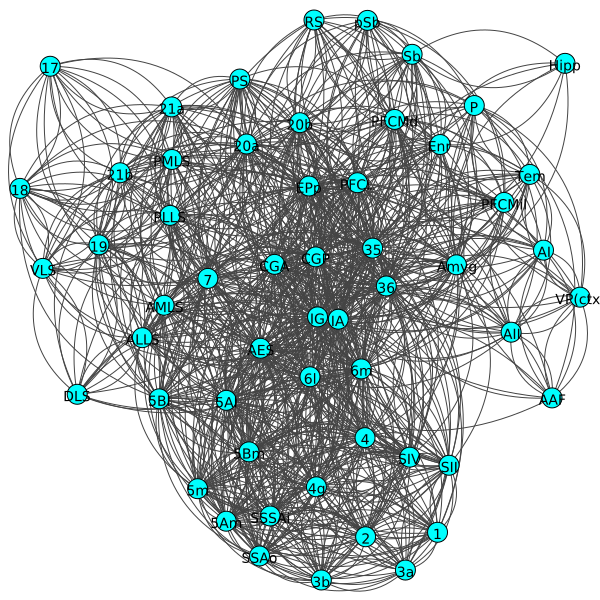

In [11]:
cortex_layout = net_cortex.layout("kk")
labels = [vertex['id'] for vertex in net_cortex.vs]
igraph.plot(net_cortex, "net_cortex.png", vertex_color="cyan", vertex_label = labels, layout = cortex_layout)

Community:
Clustering with 55 elements and 3 clusters
[0] 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 15, 36
[1] 14, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 37, 38, 39, 44
[2] 12, 16, 17, 18, 19, 20, 21, 22, 40, 41, 42, 43, 45, 46, 47, 48, 49, 50,
    51, 52, 53, 54
Membership:
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 1, 0, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 2, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
Number of communities: 3
Modularity: 0.266097341683


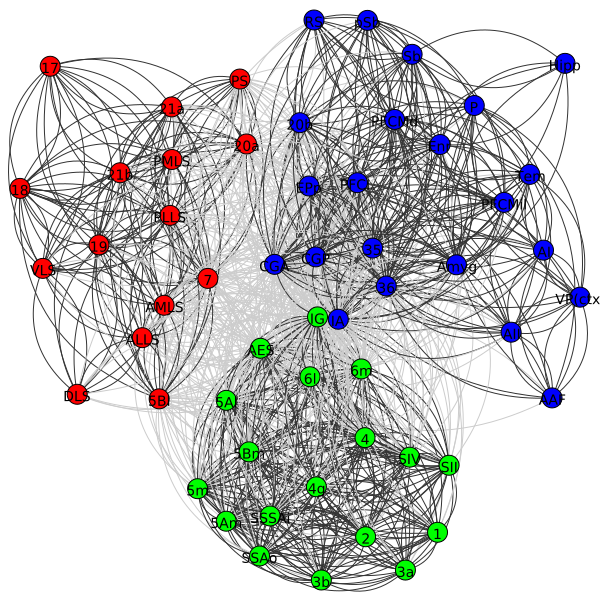

In [12]:
# Community multilevel
com_cortex = net_cortex.community_multilevel()
print "Community:"
print com_cortex
print "Membership:"
print com_cortex.membership
print "Number of communities:", max(com_cortex.membership)+1
mem_cortex = com_cortex.membership
print "Modularity:", com_cortex.modularity
export_to_clu(com_cortex.membership,"clu_multilevel_cortex.clu")
igraph.plot(com_cortex,"clu_multilevel_cortex.png", vertex_label=labels,layout = cortex_layout)

Optimal number of clusters: 3
Community:
Clustering with 55 elements and 3 clusters
[0] 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 13, 36
[1] 11, 12, 15, 16, 17, 18, 19, 20, 21, 22, 40, 41, 42, 43, 44, 45, 46, 47,
    48, 49, 50, 51, 52, 53, 54
[2] 14, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 37, 38, 39
Membership:
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
Number of communities: 3
Modularity: 0.260435528897


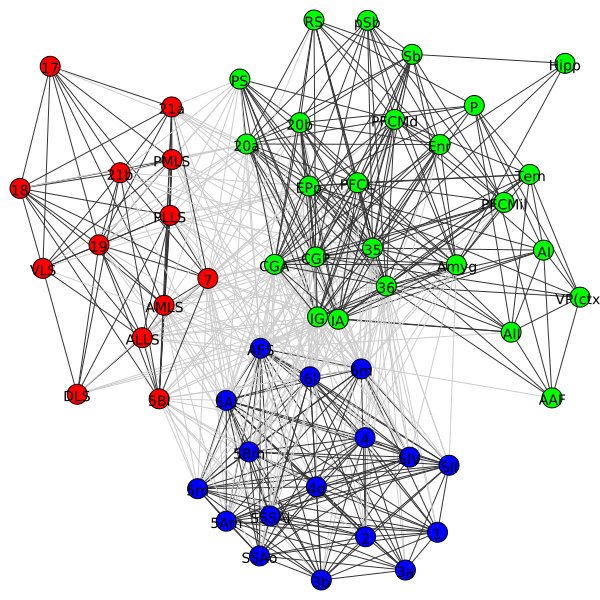

In [13]:
# Community fast-greedy
# simplified to avoid multiple edges in same node pair
com_cortex = net_cortex.simplify().community_fastgreedy().as_clustering()
print "Optimal number of clusters:",net_cortex.community_fastgreedy().optimal_count
print "Community:"
print com_cortex
print "Membership:"
print com_cortex.membership
print "Number of communities:", max(com_cortex.membership)+1
mem_cortex = com_cortex.membership
print "Modularity:", com_cortex.modularity
export_to_clu(com_cortex.membership,"clu_fastgreedy_cortex.clu")
igraph.plot(com_cortex,"clu_fastgreedy_cortex.png", vertex_label=labels,layout = cortex_layout)

Community:
Clustering with 55 elements and 3 clusters
[0] 12, 16, 17, 18, 19, 20, 21, 22, 40, 41, 42, 43, 45, 46, 47, 48, 49, 50,
    51, 52, 53, 54
[1] 14, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 37, 38, 39, 44
[2] 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 15, 36
Quality: 258.919165159
Modularity: 0.266097341683


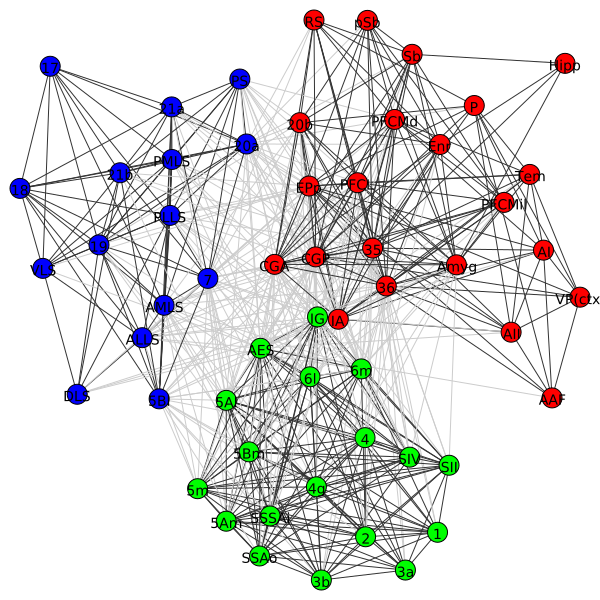

In [14]:
# Louvain
com_cortex = louvain.find_partition(net_cortex, method='Modularity')
print "Community:"
print com_cortex
print "Quality:", louvain.quality(net_cortex, com_cortex, method='Significance')
print "Modularity:", com_cortex.modularity
export_to_clu(com_cortex.membership,"clu_louvain_cortex.clu")
igraph.plot(com_cortex,"clu_louvain_cortex.png", vertex_label=labels,layout = cortex_layout)

### Dolphins

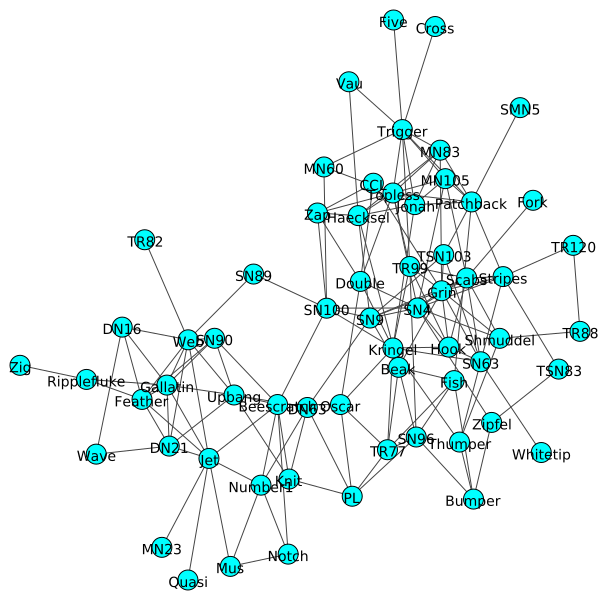

In [15]:
dolphins_layout = net_dolphins.layout("kk")
labels = [vertex['id'] for vertex in net_dolphins.vs]
igraph.plot(net_dolphins, "net_dolphins.png", vertex_color="cyan", vertex_label = labels, layout = dolphins_layout)

Community:
Clustering with 62 elements and 5 clusters
[0] 0, 2, 10, 42, 47, 53, 61
[1] 1, 7, 19, 25, 26, 27, 28, 30
[2] 12, 14, 16, 20, 33, 34, 36, 37, 38, 39, 40, 43, 44, 46, 49, 50, 52, 58
[3] 5, 6, 9, 13, 17, 22, 31, 32, 41, 48, 54, 56, 57, 60
[4] 3, 4, 8, 11, 15, 18, 21, 23, 24, 29, 35, 45, 51, 55, 59
Membership:
[0, 1, 0, 4, 4, 3, 3, 1, 4, 3, 0, 4, 2, 3, 2, 4, 2, 3, 4, 1, 2, 4, 3, 4, 4, 1, 1, 1, 1, 4, 1, 3, 3, 2, 2, 4, 2, 2, 2, 2, 2, 3, 0, 2, 2, 4, 2, 0, 3, 2, 2, 4, 2, 0, 3, 4, 3, 3, 2, 4, 3, 0]
Number of communities: 5
Modularity: 0.518531703651


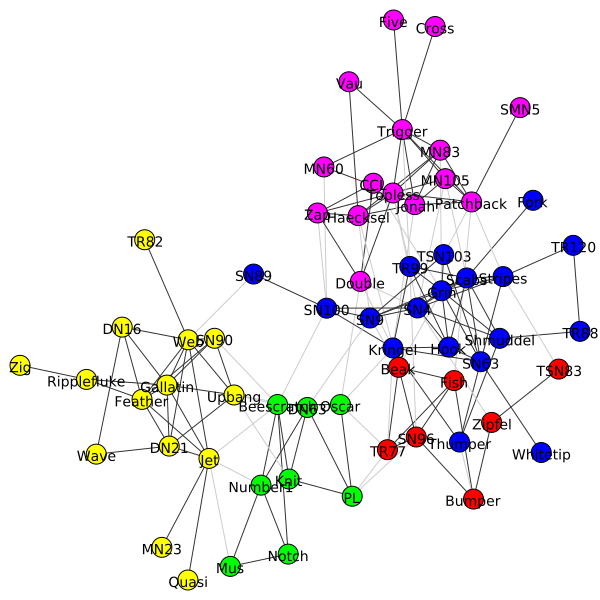

In [16]:
# Community multilevel
com_dolphins = net_dolphins.community_multilevel()
print "Community:"
print com_dolphins
print "Membership:"
print com_dolphins.membership
print "Number of communities:", max(com_dolphins.membership)+1
mem_dolphins = com_dolphins.membership
print "Modularity:", com_dolphins.modularity
export_to_clu(com_dolphins.membership,"clu_multilevel_dolphins.clu")
igraph.plot(com_dolphins,"clu_multilevel_dolphins.png", vertex_label=labels,layout = dolphins_layout)

Optimal number of clusters: 4
Community:
Clustering with 62 elements and 4 clusters
[0] 0, 2, 10, 12, 14, 16, 20, 33, 34, 37, 38, 40, 42, 43, 44, 46, 47, 49, 50,
    52, 53, 58, 61
[1] 1, 5, 6, 7, 9, 13, 17, 19, 22, 25, 26, 27, 28, 30, 31, 32, 41, 48, 54, 56,
    57, 60
[2] 3, 4, 8, 11, 15, 18, 21, 23, 24, 29, 35, 45, 51, 55, 59
[3] 36, 39
Membership:
[0, 1, 0, 2, 2, 1, 1, 1, 2, 1, 0, 2, 0, 1, 0, 2, 0, 1, 2, 1, 0, 2, 1, 2, 2, 1, 1, 1, 1, 2, 1, 1, 1, 0, 0, 2, 3, 0, 0, 3, 0, 1, 0, 0, 0, 2, 0, 0, 1, 0, 0, 2, 0, 0, 1, 2, 1, 1, 0, 2, 1, 0]
Number of communities: 4
Modularity: 0.495490684704


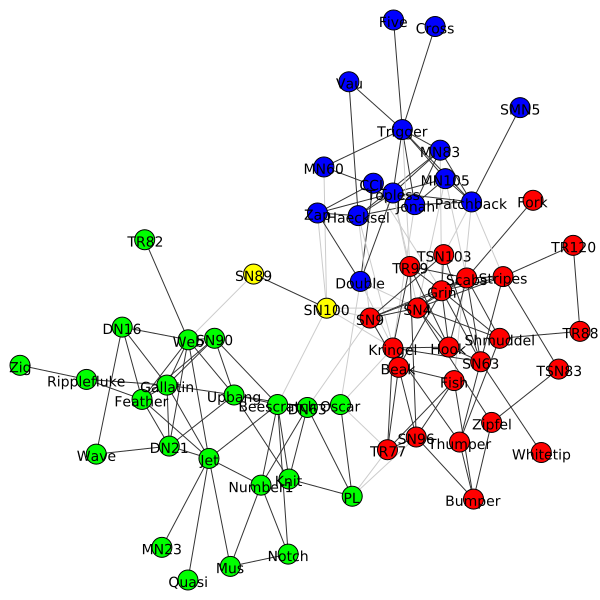

In [17]:
# Community fast-greedy
com_dolphins = net_dolphins.community_fastgreedy().as_clustering()
print "Optimal number of clusters:",net_dolphins.community_fastgreedy().optimal_count
print "Community:"
print com_dolphins
print "Membership:"
print com_dolphins.membership
print "Number of communities:", max(com_dolphins.membership)+1
mem_dolphins = com_dolphins.membership
print "Modularity:", com_dolphins.modularity
export_to_clu(com_dolphins.membership,"clu_fastgreedy_dolphins.clu")
igraph.plot(com_dolphins,"clu_fastgreedy_dolphins.png", vertex_label=labels,layout = dolphins_layout)

Community:
Clustering with 62 elements and 5 clusters
[0] 1, 5, 6, 9, 13, 17, 22, 25, 26, 27, 31, 32, 41, 48, 54, 56, 57, 60
[1] 12, 14, 16, 20, 33, 34, 37, 38, 40, 43, 44, 46, 49, 50, 52, 53, 58, 61
[2] 4, 11, 15, 18, 21, 23, 24, 29, 35, 45, 51, 55
[3] 0, 2, 7, 10, 19, 30, 42, 47
[4] 3, 8, 28, 36, 39, 59
Quality: 155.435522866
Modularity: 0.518828369131


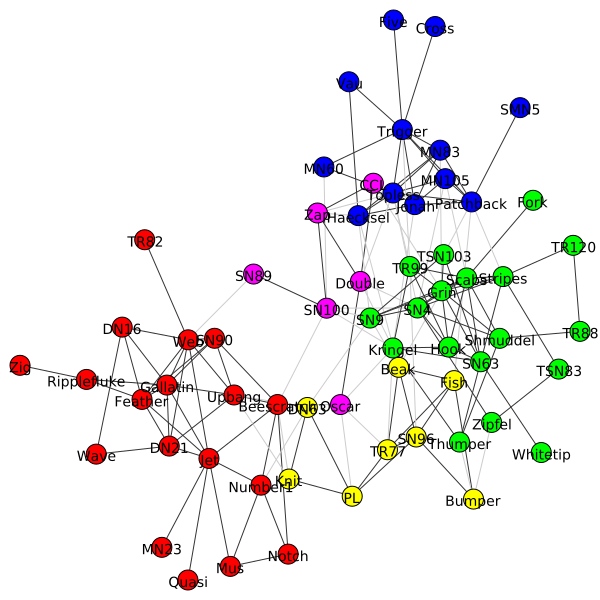

In [18]:
# Louvain
com_dolphins = louvain.find_partition(net_dolphins, method='Modularity')
print "Community:"
print com_dolphins
print "Quality:", louvain.quality(net_dolphins, com_dolphins, method='Significance')
print "Modularity:", com_dolphins.modularity
export_to_clu(com_dolphins.membership,"clu_louvain_dolphins.clu")
igraph.plot(com_dolphins,"clu_louvain_dolphins.png", vertex_label=labels,layout = dolphins_layout)

### Football

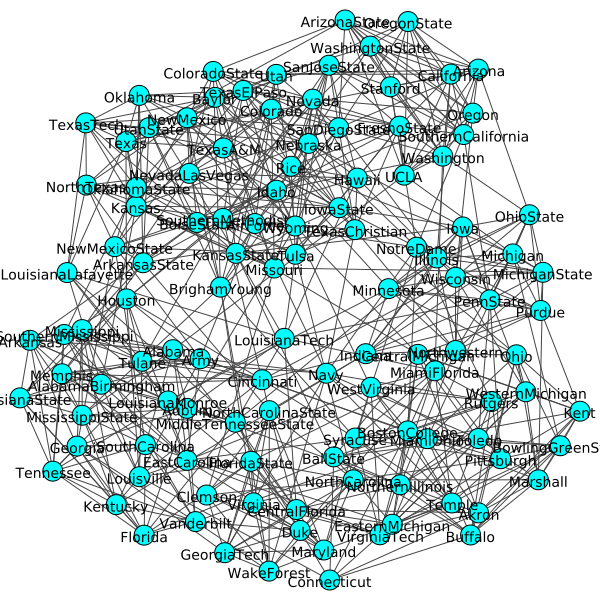

In [19]:
football_layout = net_football.layout("kk")
labels = [vertex['id'] for vertex in net_football.vs]
igraph.plot(net_football, "net_football.png", vertex_color="cyan", vertex_label = labels, layout = football_layout)

Community:
Clustering with 115 elements and 10 clusters
[ 0] 3, 5, 10, 40, 52, 72, 74, 81, 84, 98, 102, 107
[ 1] 2, 6, 13, 15, 32, 39, 47, 60, 64, 100, 106
[ 2] 1, 25, 33, 37, 45, 89, 103, 105, 109
[ 3] 12, 14, 18, 26, 31, 34, 36, 38, 42, 43, 54, 61, 71, 85, 99
[ 4] 46, 49, 53, 67, 73, 83, 88, 110, 114
[ 5] 0, 4, 9, 11, 16, 23, 24, 28, 41, 50, 69, 90, 93, 104
[ 6] 19, 29, 30, 35, 55, 79, 80, 82, 94, 101
[ 7] 17, 20, 27, 56, 58, 59, 62, 63, 65, 70, 76, 87, 95, 96, 97, 113
[ 8] 44, 48, 57, 66, 75, 86, 91, 92, 112
[ 9] 7, 8, 21, 22, 51, 68, 77, 78, 108, 111
Membership:
[5, 2, 1, 0, 5, 0, 1, 9, 9, 5, 0, 5, 3, 1, 3, 1, 5, 7, 3, 6, 7, 9, 9, 5, 5, 2, 3, 7, 5, 6, 6, 3, 1, 2, 3, 6, 3, 2, 3, 1, 0, 5, 3, 3, 8, 2, 4, 1, 8, 4, 5, 9, 0, 4, 3, 6, 7, 8, 7, 7, 1, 3, 7, 7, 1, 7, 8, 4, 9, 5, 7, 3, 0, 4, 0, 8, 7, 9, 9, 6, 6, 0, 6, 4, 0, 3, 8, 7, 4, 2, 5, 8, 8, 5, 6, 7, 7, 7, 0, 3, 1, 6, 0, 2, 5, 2, 1, 0, 9, 2, 4, 9, 8, 7, 4]
Number of communities: 10
Modularity: 0.604569562683


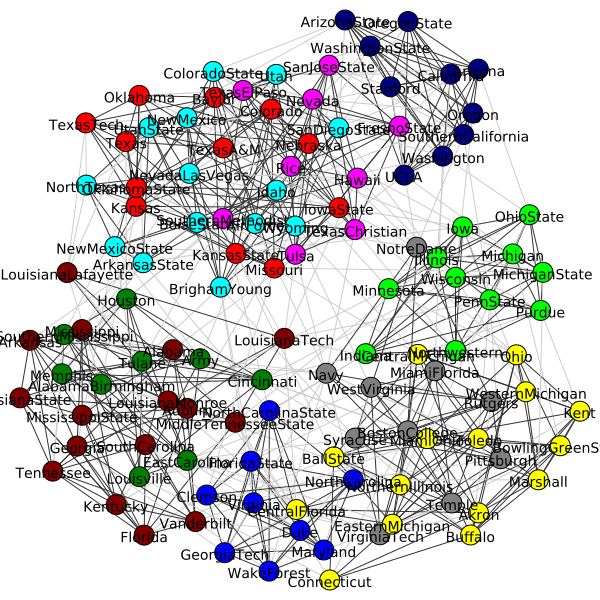

In [20]:
# Community multilevel
com_football = net_football.community_multilevel()
print "Community:"
print com_football
print "Membership:"
print com_football.membership
print "Number of communities:", max(com_football.membership)+1
mem_football = com_football.membership
print "Modularity:", com_football.modularity
export_to_clu(com_football.membership,"clu_multilevel_football.clu")
igraph.plot(com_football,"clu_multilevel_football.png", vertex_label=labels,layout = football_layout)

Optimal number of clusters: 6
Community:
Clustering with 115 elements and 6 clusters
[0] 0, 1, 19, 25, 29, 30, 33, 35, 37, 45, 55, 79, 80, 82, 89, 93, 94, 101,
    103, 105, 109
[1] 2, 3, 4, 5, 10, 11, 24, 28, 40, 50, 52, 69, 72, 74, 81, 83, 84, 90, 98,
    102, 107
[2] 6, 13, 15, 32, 39, 47, 60, 64, 100, 106
[3] 7, 8, 9, 16, 21, 22, 23, 41, 46, 49, 51, 53, 67, 68, 73, 77, 78, 88, 104,
    108, 110, 111, 114
[4] 12, 14, 18, 26, 31, 34, 38, 43, 54, 61, 71, 85, 99
[5] 17, 20, 27, 36, 42, 44, 48, 56, 57, 58, 59, 62, 63, 65, 66, 70, 75, 76,
    86, 87, 91, 92, 95, 96, 97, 112, 113
Membership:
[0, 0, 1, 1, 1, 1, 2, 3, 3, 3, 1, 1, 4, 2, 4, 2, 3, 5, 4, 0, 5, 3, 3, 3, 1, 0, 4, 5, 1, 0, 0, 4, 2, 0, 4, 0, 5, 0, 4, 2, 1, 3, 5, 4, 5, 0, 3, 2, 5, 3, 1, 3, 1, 3, 4, 0, 5, 5, 5, 5, 2, 4, 5, 5, 2, 5, 5, 3, 3, 1, 5, 4, 1, 3, 1, 5, 5, 3, 3, 0, 0, 1, 0, 1, 1, 4, 5, 5, 3, 0, 1, 5, 5, 0, 0, 5, 5, 5, 1, 4, 2, 0, 1, 0, 3, 0, 2, 1, 3, 0, 3, 3, 5, 5, 3]
Number of communities: 6
Modularity: 0.549740665143


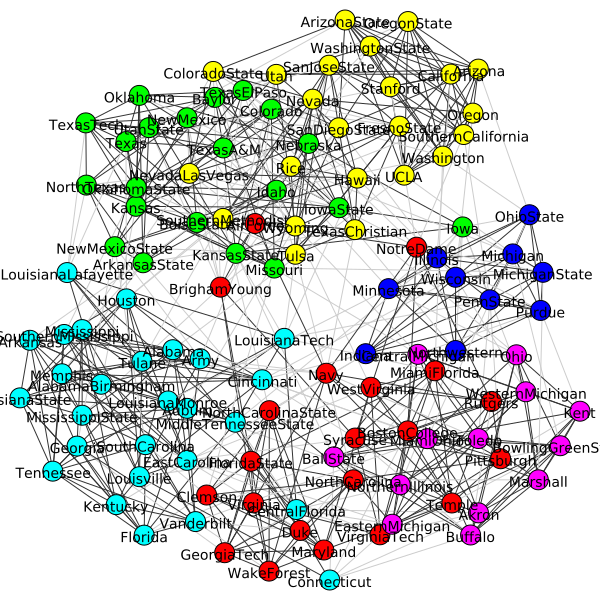

In [21]:
# Community fast-greedy
# simplified to avoid multiple edges in same node pair
com_football = net_football.simplify().community_fastgreedy().as_clustering()
print "Optimal number of clusters:",net_football.community_fastgreedy().optimal_count
print "Community:"
print com_football
print "Membership:"
print com_football.membership
print "Number of communities:", max(com_football.membership)+1
mem_football = com_football.membership
print "Modularity:", com_football.modularity
export_to_clu(com_football.membership,"clu_fastgreedy_football.clu")
igraph.plot(com_football,"clu_fastgreedy_football.png", vertex_label=labels,layout = football_layout)

Community:
Clustering with 115 elements and 10 clusters
[ 0] 17, 20, 27, 36, 56, 58, 59, 62, 63, 65, 70, 76, 87, 95, 96, 97, 113
[ 1] 0, 4, 9, 11, 16, 23, 24, 28, 41, 50, 69, 90, 93, 104
[ 2] 12, 14, 18, 26, 31, 34, 38, 42, 43, 54, 61, 71, 85, 99
[ 3] 3, 5, 10, 40, 52, 72, 74, 81, 84, 98, 102, 107
[ 4] 2, 6, 13, 15, 32, 39, 47, 60, 64, 100, 106
[ 5] 19, 29, 30, 35, 55, 79, 80, 82, 94, 101
[ 6] 7, 8, 21, 22, 51, 68, 77, 78, 108, 111
[ 7] 1, 25, 33, 37, 45, 89, 103, 105, 109
[ 8] 46, 49, 53, 67, 73, 83, 88, 110, 114
[ 9] 44, 48, 57, 66, 75, 86, 91, 92, 112
Quality: 1419.90863491
Modularity: 0.604346021093


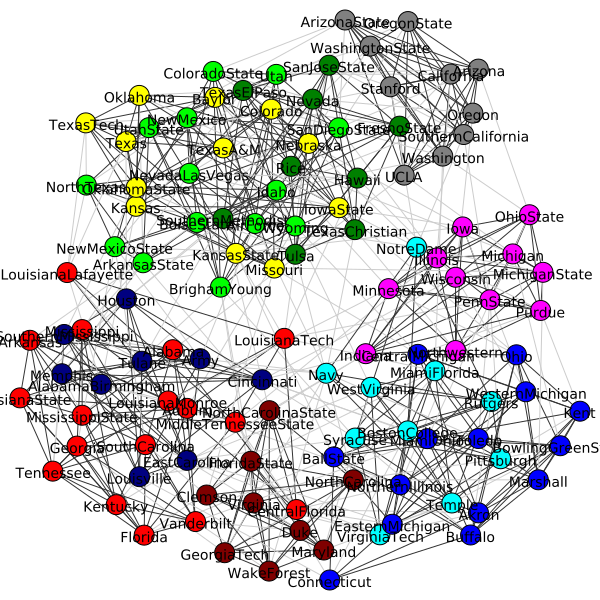

In [22]:
# Louvain
com_football = louvain.find_partition(net_football, method='Modularity')
print "Community:"
print com_football
print "Quality:", louvain.quality(net_football, com_football, method='Significance')
print "Modularity:", com_football.modularity
export_to_clu(com_football.membership,"clu_louvain_football.clu")
igraph.plot(com_football,"clu_louvain_football.png", vertex_label=labels,layout = football_layout)

### Zachary

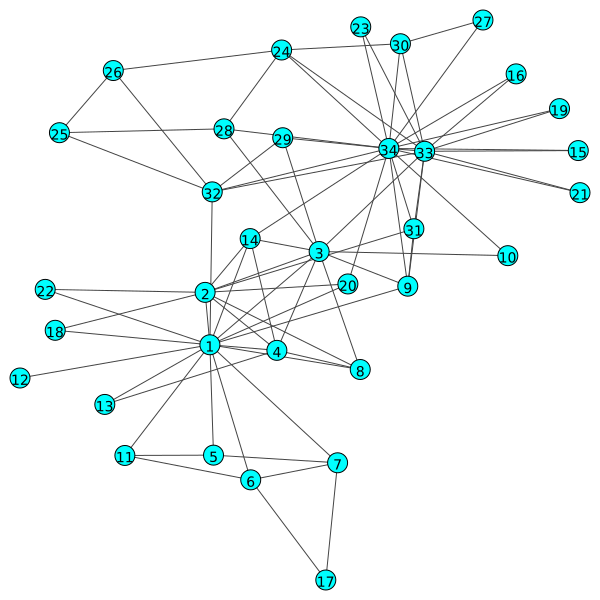

In [23]:
zachary_layout = net_zachary.layout("kk")
labels = [vertex['id'] for vertex in net_zachary.vs]
igraph.plot(net_zachary, "net_zachary.png", vertex_color="cyan", vertex_label = labels, layout = zachary_layout)

Community:
Clustering with 34 elements and 4 clusters
[0] 4, 5, 6, 10, 16
[1] 0, 1, 2, 3, 7, 9, 11, 12, 13, 17, 19, 21
[2] 23, 24, 25, 27, 28, 31
[3] 8, 14, 15, 18, 20, 22, 26, 29, 30, 32, 33
Membership:
[1, 1, 1, 1, 0, 0, 0, 1, 3, 1, 0, 1, 1, 1, 3, 3, 0, 1, 3, 1, 3, 1, 3, 2, 2, 2, 3, 2, 2, 3, 3, 2, 3, 3]
Number of communities: 4
Modularity: 0.418803418803


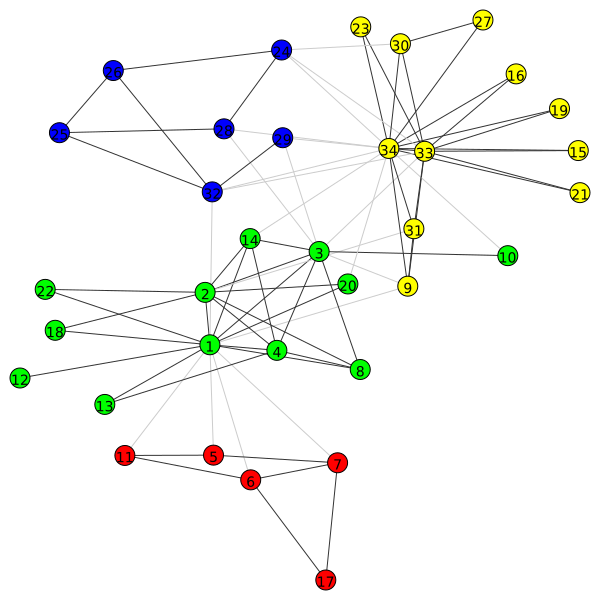

In [24]:
# Community multilevel
com_zachary = net_zachary.community_multilevel()
print "Community:"
print com_zachary
print "Membership:"
print com_zachary.membership
print "Number of communities:", max(com_zachary.membership)+1
mem_zachary = com_zachary.membership
print "Modularity:", com_zachary.modularity
export_to_clu(com_zachary.membership,"clu_multilevel_zachary.clu")
igraph.plot(com_zachary,"clu_multilevel_zachary.png", vertex_label=labels,layout = zachary_layout)


Optimal number of clusters: 3
Community:
Clustering with 34 elements and 3 clusters
[0] 0, 4, 5, 6, 10, 11, 16, 19
[1] 1, 2, 3, 7, 9, 12, 13, 17, 21
[2] 8, 14, 15, 18, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33
Membership:
[0, 1, 1, 1, 0, 0, 0, 1, 2, 1, 0, 0, 1, 1, 2, 2, 0, 1, 2, 0, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
Number of communities: 3
Modularity: 0.38067061144


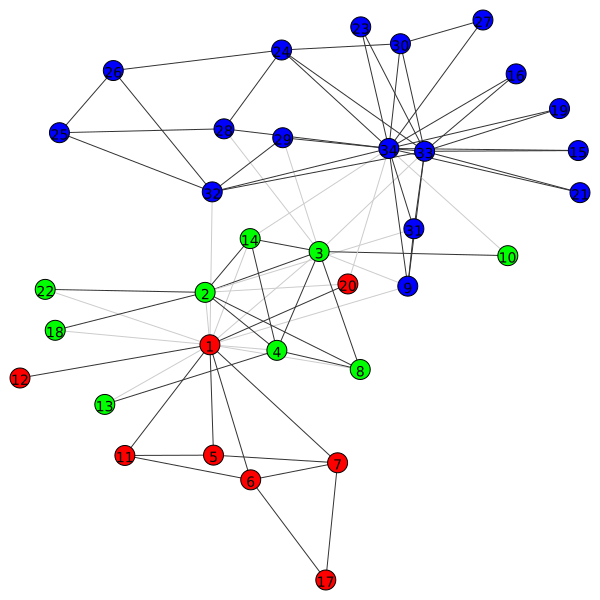

In [25]:
# Community fast-greedy
# simplified to avoid multiple edges in same node pair
com_zachary = net_zachary.simplify().community_fastgreedy().as_clustering()
print "Optimal number of clusters:",net_zachary.community_fastgreedy().optimal_count
print "Community:"
print com_zachary
print "Membership:"
print com_zachary.membership
print "Number of communities:", max(com_zachary.membership)+1
mem_zachary = com_zachary.membership
print "Modularity:", com_zachary.modularity
export_to_clu(com_zachary.membership,"clu_fastgreedy_zachary.clu")
igraph.plot(com_zachary,"clu_fastgreedy_zachary.png", vertex_label=labels,layout = zachary_layout)


Community:
Clustering with 34 elements and 4 clusters
[0] 8, 9, 14, 15, 18, 20, 22, 26, 29, 30, 32, 33
[1] 0, 1, 2, 3, 7, 11, 12, 13, 17, 19, 21
[2] 23, 24, 25, 27, 28, 31
[3] 4, 5, 6, 10, 16
Quality: 60.0511230528
Modularity: 0.419789612097


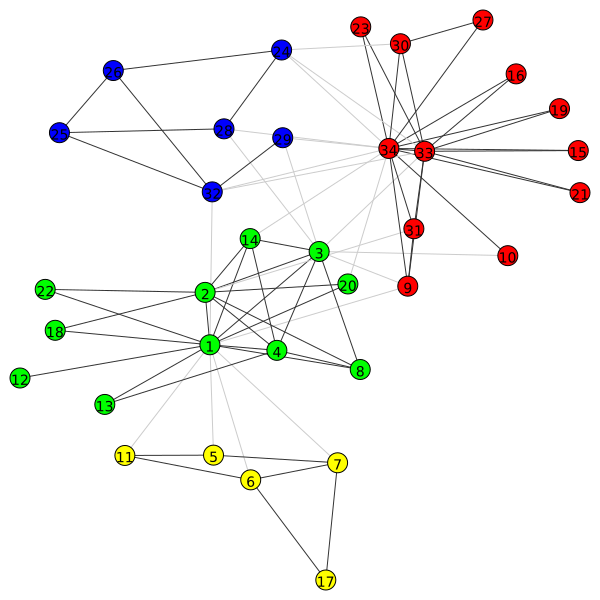

In [26]:
# Louvain
com_zachary = louvain.find_partition(net_zachary, method='Modularity')
print "Community:"
print com_zachary
print "Quality:", louvain.quality(net_zachary, com_zachary, method='Significance')
print "Modularity:", com_zachary.modularity
export_to_clu(com_zachary.membership,"clu_louvain_zachary.clu")
igraph.plot(com_zachary,"clu_louvain_zachary.png", vertex_label=labels,layout = zachary_layout)